In [6]:
import os
import subprocess
from tqdm import tqdm

dir_path = '/remote_training/richard/a/kubric/outputs'

count = 0

subdirs = list(os.listdir(dir_path))[:400]

for subdir in tqdm(subdirs):
    new_dir = '/remote_training/richard/a/kubric/outputs_converter_4'
    os.makedirs(new_dir, exist_ok=True)
    subdir_path = os.path.join(dir_path, subdir)
    command = f"mv {subdir_path} {new_dir}"
    # print(command)
    result = subprocess.run(command, shell=True)




100%|██████████| 342/342 [00:01<00:00, 238.56it/s]


In [14]:
import os
import subprocess

old_dir = '/remote_training/richard/a/kubric/outputs_converter_0'
new_dir = '/remote_training/richard/a/kubric/outputs_converter'
command = f"mv {old_dir} {new_dir}"

result = subprocess.run(command, shell=True)


## Parse raw text

In [8]:
import json

with open('/remote_training/richard/a/map/output_raw.json', 'r') as file:
    texts = json.load(file)

valids = {}

for text in texts:
    splits = text.split('\n')


    for split in splits:
        split = split.strip()
        if split.startswith('*'):
            place = split.split('*')[1].strip()

            if place not in valids:
                valids[place] = 0
            
            valids[place] += 1

valids
        

{"Old Chemistry Building's courtyard": 1,
 "Stanfrod Career Education's garden": 1,
 'Campanile Walk and Stanford Campanile': 1,
 'Quiet Tresidder Student Union': 1,
 'Oak grove near the  Stanford old quad': 1,
 'Engineering Outdoor Amphitheater': 1,
 "The Old Quad's buildings 1 through 10. These include Old Building which served as the university's first library": 1,
 "A lesser-known outdoor reading courtyard (the 'quiet reading courtyard')": 1,
 'A walking path in the Quadrangles  and Bike and Walk route known as the Old Central pathway': 1,
 'Old Chemistry Building': 1,
 'an abandoned old Library building ( demolished and destroyed in 1970)': 1,
 'Sutardja Dai Hall': 1,
 'Roble Archive Gallery': 1,
 'Stanford University Historic District  ("Little Library")': 1,
 'Roble Garden': 1,
 'Quarry Lake': 1,
 'Artists on the Move': 1,
 'El Camino Gardens': 1,
 'Stanford University Museum of Natural History': 1,
 'Mausoleum at the Stanford Golf Course': 1,
 'Elizabeth Gerhardt sculpture gard

In [ ]:
text = "Here's the 2-hour trip plan for you:\n\nWe can visit the Cantor Arts Center, Hoover Tower, Memorial Church, and then walk through the charming Green Library Quad, making a quick stop at the beautifully landscaped Tresidder Union area to rest and recharge before visiting the vibrant Arrillaga Alumni Center for a panoramic view of the Quad.\n\n\nThis tour will give you a taste of academic life and stunning architecture at Stanford University's prestigious campus.\n\n \n* The Cantor Arts Center\n* Hoover Tower\n* The Oval \n* Tresidder Union\n* Arrillaga Alumni Center\n* Green Library Quad\n* Memorial Church"

def parse_locations(text):
    """
    Parses the list of locations at the bottom of the text chunk (marked by '\n *').
    
    Args:
    - text (str): The input text containing the location list.
    
    Returns:
    - list: A list of location names.
    """
    # Split the text into lines
    lines = text.split('\n')
    
    # Extract lines starting with ' * ' and remove the '* ' marker
    locations = [line.strip()[2:].strip() for line in lines if line.strip().startswith('*')]
    
    return locations

















In [5]:
import os
import shutil
from pathlib import Path
import concurrent.futures
import tarfile

# Paths
base_dir = Path("/remote_training/richard/a/kubric/outputs_1100")
new_base_dir = base_dir / "grouped_outputs"  # Directory to hold grouped subdirectories
new_base_dir.mkdir(exist_ok=True)

# Step 1: Organize 1100 subdirectories into 110 groups of 10 subdirectories each
def organize_subdirectories():
    subdirs = [subdir for subdir in base_dir.iterdir() if subdir.is_dir() and subdir != new_base_dir]
    num_groups = 110
    group_size = 10

    for i in range(num_groups):
        group_dir = new_base_dir / f"group_{i+1}"
        group_dir.mkdir(exist_ok=True)
        
        # Move 10 subdirectories to this group directory
        for subdir in subdirs[i * group_size : (i + 1) * group_size]:
            shutil.move(str(subdir), str(group_dir))

# Step 2: Compress each group in parallel
def compress_directory(group_dir):
    archive_path = f"{group_dir}.tar.gz"
    with tarfile.open(archive_path, "w:gz") as tar:
        tar.add(group_dir, arcname=group_dir.name)
    print(f"Compressed {group_dir} into {archive_path}")

# Run the organization and compression with multithreading
def main():
    # Organize subdirectories into groups
    organize_subdirectories()
    
    # Compress each group in parallel
    with concurrent.futures.ThreadPoolExecutor() as executor:
        group_dirs = [group for group in new_base_dir.iterdir() if group.is_dir()]
        executor.map(compress_directory, group_dirs)

if __name__ == "__main__":
    main()


Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_100 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_100.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_101 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_101.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_102 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_102.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_105 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_105.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_108 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_108.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_109 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/gro

KeyboardInterrupt: 

Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_11 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_11.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_22 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_22.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_17 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_17.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_19 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_19.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_30 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_30.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_33 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_33.tar.g

/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_54.tar.gz: Broken pipe


Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_54 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_54.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_40 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_40.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_46 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_46.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_39 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_39.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_45 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_45.tar.gz
Compressed /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_4 into /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_4.tar.gz


In [ ]:
import os
import subprocess
from pathlib import Path
import concurrent.futures

# Source and destination paths
source_dir = Path("/remote_training/richard/a/kubric/outputs_1100/grouped_outputs")
destination = "yrichard@scdt.stanford.edu:/orion/group/kubric_points/richard/outputs"

# Function to copy a single file using scp
def copy_file(file_path):
    try:
        print(f"Copying {file_path} to {destination}")
        subprocess.run(["scp", str(file_path), destination], check=True)
        print(f"Successfully copied {file_path}")
    except subprocess.CalledProcessError as e:
        print(f"Failed to copy {file_path}: {e}")

# Main function to initiate multithreaded copying
def main():
    # List all .tar.gz files in the source directory
    files_to_copy = [file for file in source_dir.glob("group_*.tar.gz") if file.is_file()]
    print(files_to_copy)
    # raise ValueError
    # Copy files in parallel using ThreadPoolExecutor
    with concurrent.futures.ThreadPoolExecutor() as executor:
        executor.map(copy_file, files_to_copy)

if __name__ == "__main__":
    main()


[PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_1.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_10.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_11.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_12.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_13.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_14.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_15.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_16.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_17.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_18.tar.gz'), PosixPath('/remote_training/richard/a/kubric/outputs_1100/grouped_outp

ValueError: 

In [3]:
files_to_copy

NameError: name 'files_to_copy' is not defined

In [11]:
import tensorflow_datasets as tfds
import tensorflow as tf
from challenges.movi.movi_f import MoviF, MoviFConfig

# Create a configuration for the dataset
config = MoviFConfig(
    name="custom_512x512",
    description="A custom MOVi-F dataset in 512x512 resolution",
    height=512,
    width=512,
    validation_ratio=0.1,  # Adjust validation ratio as desired
    train_val_path="/remote_training/richard/a/kubric/output_3"  # Change this to your directory
)

# Initialize the dataset builder
dataset_builder = MoviF(config=config, data_dir='/remote_training/richard/a/kubric/output_3')

# Generate dataset metadata
# dataset_builder.info()

# Build the dataset (this could take time depending on the size of the dataset)
dataset_builder.download_and_prepare()

separate module. To migrate, use:

```
from etils import epath
path = epath.Path('gs://path/to/f.txt')
```

Alternatively `tfds.core.Path` is an alias of `epath.Path`.

Installation: `pip install etils[epath]`


Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

usage: ipykernel_launcher.py [-h] [--dataflow_endpoint DATAFLOW_ENDPOINT]
                             [--project PROJECT] [--job_name JOB_NAME]
                             [--staging_location STAGING_LOCATION]
                             [--temp_location TEMP_LOCATION] [--region REGION]
                             [--service_account_email SERVICE_ACCOUNT_EMAIL]
                             [--no_auth]
                             [--template_location TEMPLATE_LOCATION]
                             [--label LABELS] [--update]
                             [--transform_name_mapping TRANSFORM_NAME_MAPPING]
                             [--enable_streaming_engine]
                             [--dataflow_kms_key DATAFLOW_KMS_KEY]
                             [--create_from_snapshot CREATE_FROM_SNAPSHOT]
                             [--flexrs_goal {COST_OPTIMIZED,SPEED_OPTIMIZED}]
                             [--dataflow_service_option DATAFLOW_SERVICE_OPTIONS]
                           

**************************** WARNING *********************************
yet no `beam_runner` nor `beam_options` was explicitly provided.

Some Beam datasets take weeks to generate, so are usually not suited
for single machine generation. Please have a look at the instructions
to setup distributed generation:

https://www.tensorflow.org/datasets/beam_datasets#generating_a_beam_dataset
**********************************************************************


AttributeError: 'tuple' object has no attribute 'tb_frame'

In [10]:
!pip install apache_beam

  Using cached apache_beam-2.60.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (7.6 kB)
  Using cached crcmod-1.7.tar.gz (89 kB)
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.0/152.0 kB 12.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.5/43.5 kB 6.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 101.9 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 33.9 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 115.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 72.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 158.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━

In [1]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image

def display_images_as_video(image_paths, fps=12):
    """
    Display a sequence of images as a video at the specified frame rate.
    
    Args:
    - image_paths (list): List of paths to images.
    - fps (int): Frames per second. Default is 12.
    """
    # Calculate interval between frames based on the fps
    interval = int(1000 / fps)
    
    # Load all images into memory
    images = [Image.open(img_path) for img_path in image_paths]
    
    # Initialize the figure
    fig, ax = plt.subplots()
    ax.axis('off')  # Hide axes
    
    # Display the first image
    img_display = ax.imshow(images[0])
    
    # Animation update function
    def update_frame(i):
        img_display.set_array(images[i])
        return img_display,
    
    # Create the animation
    ani = animation.FuncAnimation(fig, update_frame, frames=len(images), interval=interval, blit=True)
    
    # Display the animation
    plt.show()



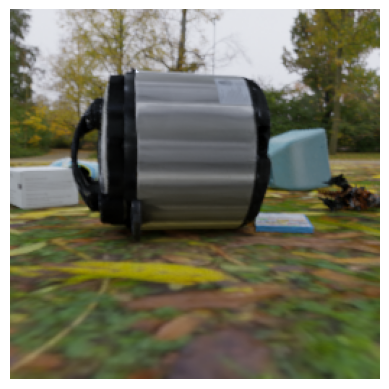

In [2]:
image_paths = [f'/remote_training/richard/a/kubric/output/rgba_{number:05d}.png' for number in range(16)]
display_images_as_video(image_paths=image_paths)

In [2]:
import tensorflow as tf
import tensorflow_datasets.public_api as tfds

ds = tfds.load("movi_f", data_dir="gs://kubric-public/tfds") 


2024-11-09 00:18:14.605127: W tensorflow/tsl/platform/cloud/google_auth_provider.cc:184] All attempts to get a Google authentication bearer token failed, returning an empty token. Retrieving token from files failed with "NOT_FOUND: Could not locate the credentials file.". Retrieving token from GCE failed with "FAILED_PRECONDITION: Error executing an HTTP request: libcurl code 6 meaning 'Couldn't resolve host name', error details: Could not resolve host: metadata.google.internal".


: 

: 

Animation size has reached 21070994 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


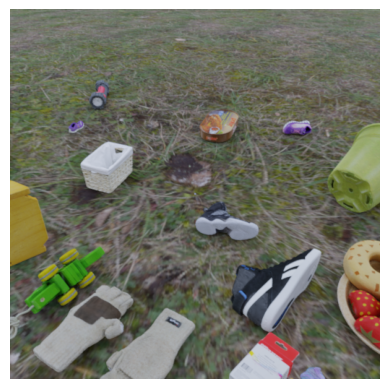

In [6]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image
from IPython.display import HTML

def display_images_as_video(image_paths, fps=12):
    """
    Display a sequence of images as a video at the specified frame rate in a Jupyter Notebook.
    
    Args:
    - image_paths (list): List of paths to images.
    - fps (int): Frames per second. Default is 12.
    """
    # Calculate interval between frames based on the fps
    interval = int(1000 / fps)
    
    # Load all images into memory
    images = [Image.open(img_path) for img_path in image_paths]
    
    # Initialize the figure
    fig, ax = plt.subplots()
    ax.axis('off')  # Hide axes
    
    # Display the first image
    img_display = ax.imshow(images[0])
    
    # Animation update function
    def update_frame(i):
        img_display.set_array(images[i])
        return img_display,
    
    # Create the animation
    ani = animation.FuncAnimation(fig, update_frame, frames=len(images), interval=interval, blit=True)
    
    # Display the animation inline in Jupyter Notebook
    return HTML(ani.to_jshtml())

# Example usage
image_paths = [f"/remote_training/richard/a/kubric/outputs/output_2024_11_10_06_07_12/rgba_{i:05d}.png" for i in range(64)]  # Example paths
display_images_as_video(image_paths, fps=12)


In [1]:
import tensorflow_datasets as tfds

# Load your custom MoviF dataset from the directory where TFRecords were saved
data_dir = "/remote_training/richard/a/kubric/saved_sample"  # Adjust to the path containing 'movi_f'
dataset_name = "movi_f/custom_512x512"

# Load the dataset
dataset, info = tfds.load(dataset_name, data_dir=data_dir, split='train', with_info=True)

# Print dataset information to verify the structure
# print("Dataset Info:")
# print(info)

# Check some samples from the dataset
for example in dataset.take(1):
    # Access the 'video' field and convert it to a NumPy array
    video = example['video'].numpy()  # Shape: (sequence_length, height, width, channels)
    
    # Print a portion of the video data to inspect
    print("Video sample:")
    print(video.shape)  # Print a 5x5 slice of the first frame


2024-11-24 01:10:11.891400: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-24 01:10:11.914034: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1732410611.942714  818846 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1732410611.951891  818846 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-24 01:10:11.977645: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

Video sample:
(64, 512, 512, 3)


2024-11-24 01:10:21.461730: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [2]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np

def visualize_video_html5(video):
    """
    Visualize a 4D video tensor (frames, height, width, channels) as an HTML5 animation in Jupyter Notebook.
    
    Args:
    - video (numpy.ndarray): Video data with shape (num_frames, height, width, channels).
    """
    num_frames, height, width, channels = video.shape

    # Initialize the figure
    fig, ax = plt.subplots()
    ax.axis('off')  # Hide axes for better visualization

    # Display the first frame
    frame_display = ax.imshow(video[0])

    # Update function for animation
    def update_frame(i):
        frame_display.set_array(video[i])
        return [frame_display]

    # Create animation
    ani = animation.FuncAnimation(
        fig, update_frame, frames=num_frames, interval=83, blit=True
    )

    # Save animation as HTML5 video
    video_html = ani.to_html5_video()
    plt.close(fig)  # Close the figure to avoid displaying a static plot

    # Display the HTML5 video
    return HTML(video_html)

# Example usage
# Assuming `video` is the numpy array with shape (64, 512, 512, 3)
# video = np.random.randint(0, 255, (64, 512, 512, 3), dtype=np.uint8)  # Sample data for testing
# visualize_video_html5(video)


In [3]:
visualize_video_html5(video)

In [19]:
raw_record = raw_dataset.take(1)

In [20]:
raw_record

<_TakeDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>

In [ ]:
raw_record

In [5]:
import tensorflow_datasets as tfds
import datasets
print(datasets.__version__)


2.16.0


In [ ]:
import subprocess
import os

env = os.environ.copy()

for num in range(1, 56):
    command = f"rm -r /remote_training/richard/a/kubric/outputs_1100/grouped_outputs/group_{num}"

    result = subprocess.run(command, env=env, shell=True)